In [2]:
import tensorflow as tf
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import models
import os
import utils
import glob
import visualize

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0)
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [3]:
def sample_noise(batch_size, dim):
    return np.random.normal(size=[batch_size, dim])

def preprocess_fn(img):
    re_size = 64
    img = tf.to_float(tf.image.resize_images(img, [re_size, re_size], method=tf.image.ResizeMethod.BICUBIC)) / 127.5 - 1
    return img

def post_process(img):
    return (img+1) * 127.5

In [4]:
batch_size = 64
img_paths = glob.glob('dataset/extra_data/images/*.jpg')
data_pool = utils.DiskImageData(img_paths, batch_size, shape=[96, 96, 3], preprocess_fn=preprocess_fn)

 [*] DiskImageData: create session!


In [6]:
def run_a_gan(sess, G_train_step, G_loss, D_train_step, D_loss, G_extra_step, D_extra_step, saver,\
              show_every=250, print_every=50, batch_size=128, num_epoch=10, n_critic=5):
    
    G_losses, D_losses = [], []
    max_iter = len(data_pool)*num_epoch // (batch_size * n_critic)
    for it in range(max_iter):
        # show generated iamges
        if it % show_every == 0:
            mini_z = sample_noise(100, noise_dim) 
            samples = sess.run(G_sample, feed_dict={z:mini_z})
            fig = visualize.show_images(samples, post_process=post_process)
            plt.show()
            print()
        # show losses
        if (it+1) % (show_every * 3) == 0:
            plt.plot(range(len(D_losses)), D_losses)
            plt.show()
            plt.plot(range(len(G_losses)), G_losses)
            plt.show()
            D_losses.clear()
            G_losses.clear()
            saver.save(sess, 'checkpoints/comic-generation', it)
        # train D
        for i in range(n_critic):
            minibatch = data_pool.batch()
            mini_z = sample_noise(batch_size, noise_dim)
            _, D_loss_curr = sess.run([D_train_step, D_loss], feed_dict={x:minibatch, z:mini_z})
            D_losses.append(D_loss_curr)
        # train G
        mini_z = sample_noise(batch_size, noise_dim)
        _, G_loss_curr = sess.run([G_train_step, G_loss], feed_dict={z:mini_z})
        G_losses.append(G_loss_curr)
         # print loss
        if it % print_every == 0:
            print('Iter: {}/{}, D: {:.4}, G:{:.4}'.format(it, max_iter,D_loss_curr, G_loss_curr))
            
    print('Final images')
    mini_z = sample_noise(100, noise_dim)
    samples = sess.run(G_sample, feed_dict={z:mini_z})
    
    fig = visualize.show_images(samples, final="./images/WGAN-GP(vanilla, 100 epoch)", post_process=post_process) 
    plt.show()
    saver.save(sess, 'checkpoints/comic-generation', max_iter)

In [7]:
tf.reset_default_graph()

noise_dim = 100

x = tf.placeholder(tf.float32, [None, 64, 64, 3])
z = tf.placeholder(tf.float32, [None, noise_dim])
generator = models.generator
discriminator = models.discriminator

G_sample = generator(z, reuse=False)
logits_real = discriminator(x, reuse=False)
logits_fake = discriminator(G_sample)

D_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, 'discriminator')
G_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, 'generator')

In [8]:
def wgangp_loss(logits_real, logits_fake, batch_size, x, G_sample):
    
    D_loss = tf.reduce_mean(logits_fake) - tf.reduce_mean(logits_real)
    G_loss = -tf.reduce_mean(logits_fake)
    
    lam = 10
    shape = tf.concat((tf.shape(x)[0:1], tf.tile([1], [x.shape.ndims - 1])), axis=0)
    eps = tf.random_uniform(shape=shape, minval=0., maxval=1.)
    x_hat = x + eps * (G_sample - x)
    
    pred = discriminator(x_hat)
    grad_D_x_hat = tf.gradients(pred, x)[0]
    
    # if change to reduction_indices=tf.range(x.shape.ndims)
    # then all the out images almostly the same
    grad_norm = tf.sqrt(tf.reduce_sum(tf.square(grad_D_x_hat), reduction_indices=tf.range(1, x.shape.ndims)))
    grad_pen = lam * tf.reduce_mean((grad_norm - 1.) ** 2)
    D_loss += grad_pen
    
    return D_loss, G_loss

D_loss, G_loss = wgangp_loss(logits_real, logits_fake, batch_size, x, G_sample)
D_train_step = tf.train.AdamOptimizer(learning_rate=2e-4, beta1=0.5).minimize(D_loss, var_list=D_vars)
G_train_step = tf.train.AdamOptimizer(learning_rate=2e-4, beta1=0.5).minimize(G_loss, var_list=G_vars)
D_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS, 'discriminator')
G_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS, 'generator')

INFO:tensorflow:Restoring parameters from checkpoints\comic-generation-4592


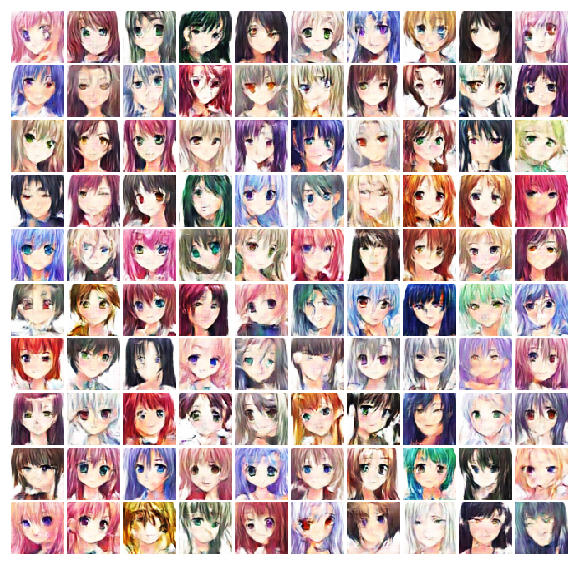


Iter: 0/5740, D: -5.056, G:-932.1
Iter: 50/5740, D: -6.702, G:-940.0
Iter: 100/5740, D: -2.816, G:-942.0
Iter: 150/5740, D: -9.984, G:-956.3
Iter: 200/5740, D: -4.18, G:-968.3


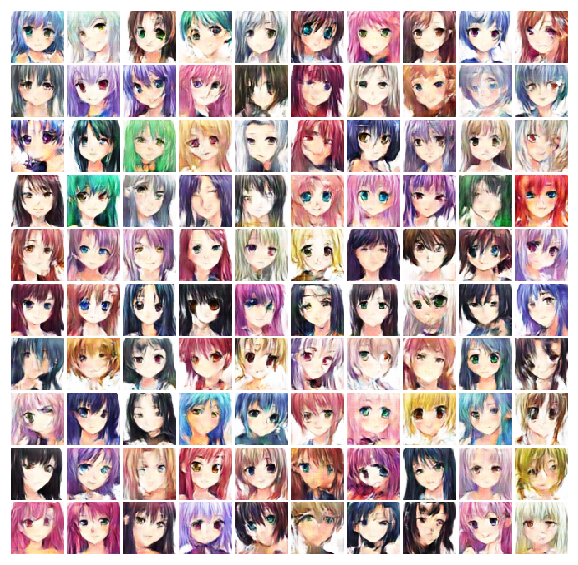


Iter: 250/5740, D: -8.585, G:-968.8
Iter: 300/5740, D: -9.999, G:-977.0
Iter: 350/5740, D: -10.4, G:-990.9
Iter: 400/5740, D: -7.91, G:-995.3
Iter: 450/5740, D: -4.171, G:-1.01e+03


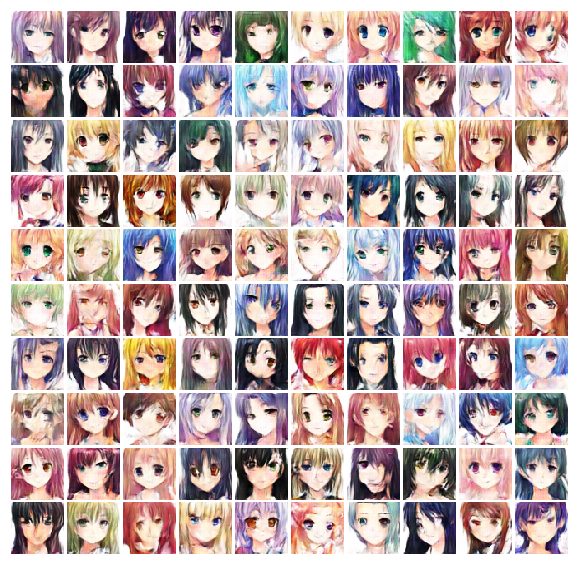


Iter: 500/5740, D: -4.122, G:-1.009e+03
Iter: 550/5740, D: -7.905, G:-1.006e+03
Iter: 600/5740, D: -6.084, G:-1.017e+03
Iter: 650/5740, D: -10.67, G:-1.015e+03
Iter: 700/5740, D: -7.072, G:-1.023e+03


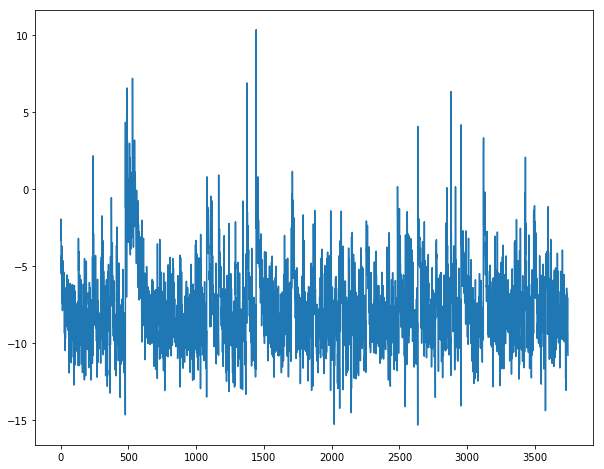

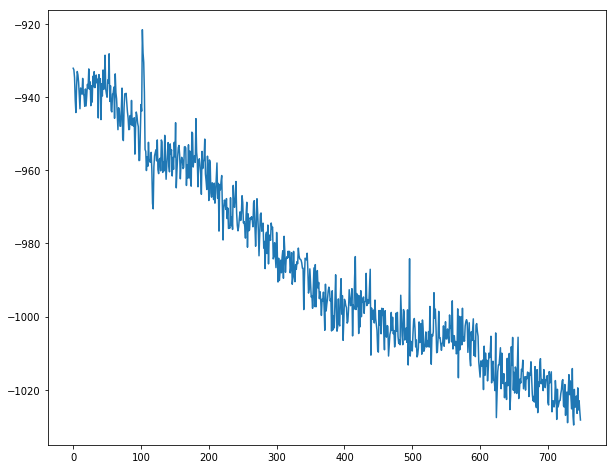

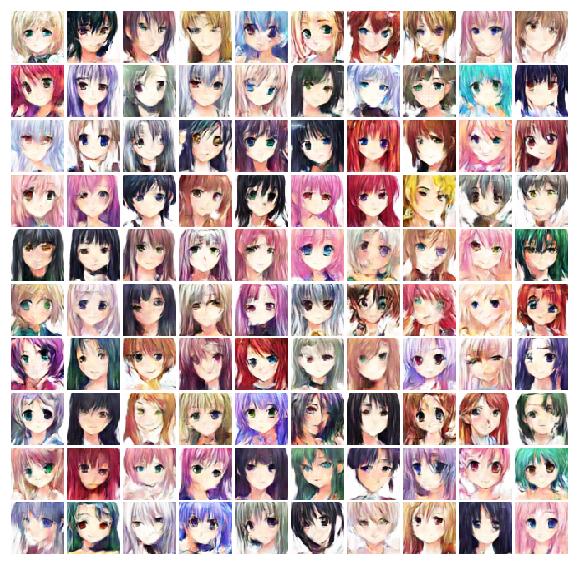


Iter: 750/5740, D: -8.511, G:-1.017e+03
Iter: 800/5740, D: -1.718, G:-1.045e+03
Iter: 850/5740, D: -7.682, G:-1.036e+03
Iter: 900/5740, D: -2.843, G:-1.037e+03
Iter: 950/5740, D: -4.629, G:-1.043e+03


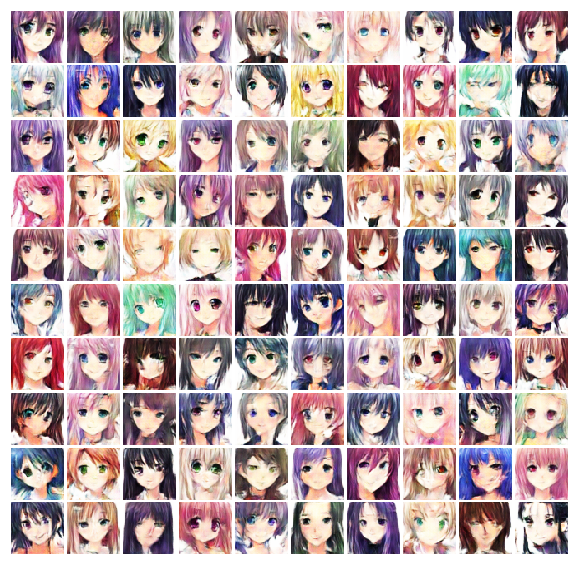


Iter: 1000/5740, D: -8.301, G:-1.049e+03
Iter: 1050/5740, D: -8.716, G:-1.057e+03
Iter: 1100/5740, D: -5.883, G:-1.062e+03
Iter: 1150/5740, D: -7.519, G:-1.068e+03
Iter: 1200/5740, D: -10.25, G:-1.07e+03


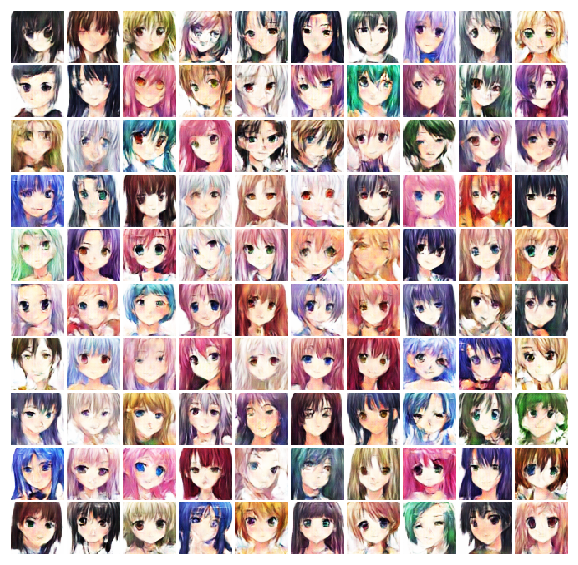


Iter: 1250/5740, D: -8.991, G:-1.072e+03
Iter: 1300/5740, D: -6.859, G:-1.089e+03
Iter: 1350/5740, D: -4.195, G:-1.089e+03
Iter: 1400/5740, D: -9.633, G:-1.081e+03
Iter: 1450/5740, D: -7.069, G:-1.083e+03


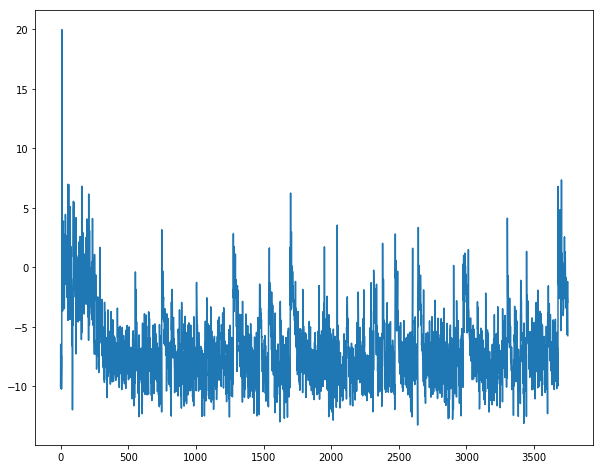

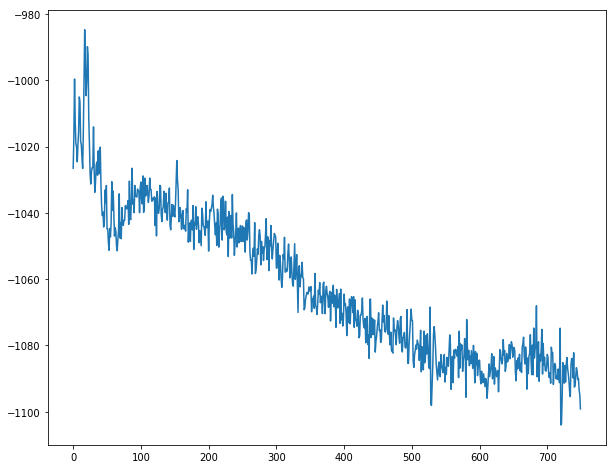

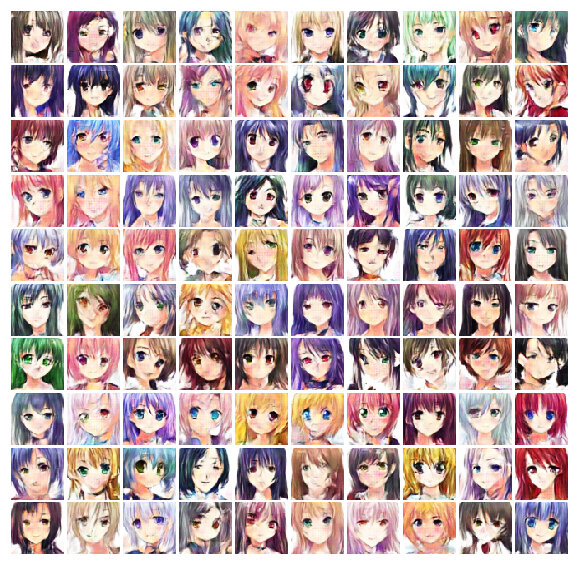


Iter: 1500/5740, D: -5.707, G:-1.1e+03
Iter: 1550/5740, D: -7.467, G:-1.094e+03
Iter: 1600/5740, D: -9.271, G:-1.099e+03
Iter: 1650/5740, D: -5.584, G:-1.109e+03
Iter: 1700/5740, D: -8.566, G:-1.115e+03


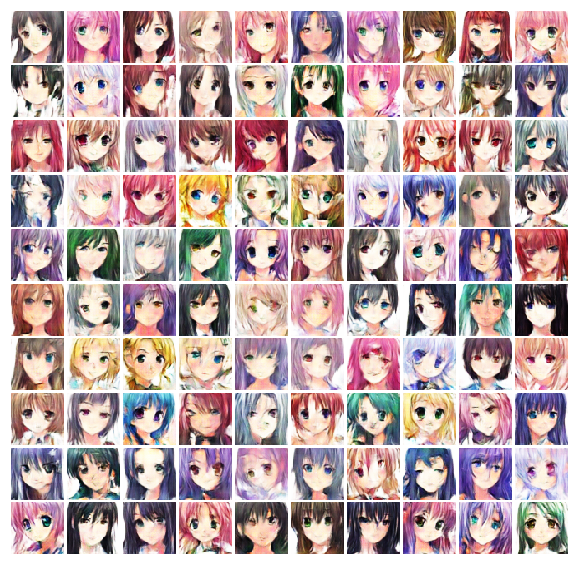


Iter: 1750/5740, D: -8.791, G:-1.124e+03
Iter: 1800/5740, D: -5.083, G:-1.13e+03
Iter: 1850/5740, D: -6.806, G:-1.125e+03
Iter: 1900/5740, D: -6.617, G:-1.141e+03
Iter: 1950/5740, D: -7.784, G:-1.135e+03


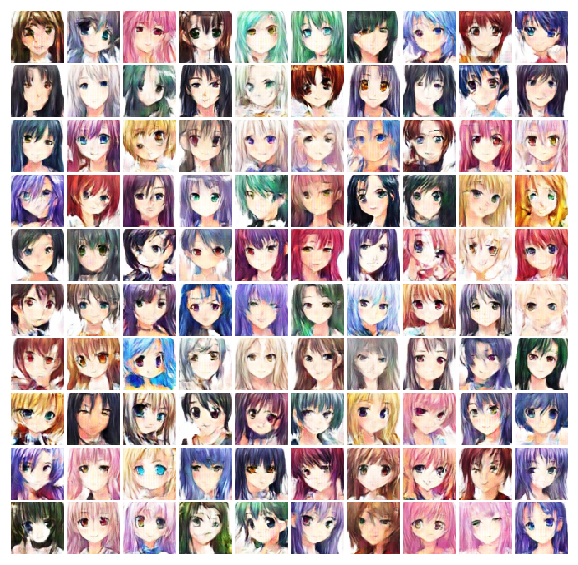


Iter: 2000/5740, D: -4.231, G:-1.145e+03
Iter: 2050/5740, D: 1.404, G:-1.146e+03
Iter: 2100/5740, D: -7.831, G:-1.155e+03
Iter: 2150/5740, D: -6.242, G:-1.157e+03
Iter: 2200/5740, D: -6.655, G:-1.163e+03


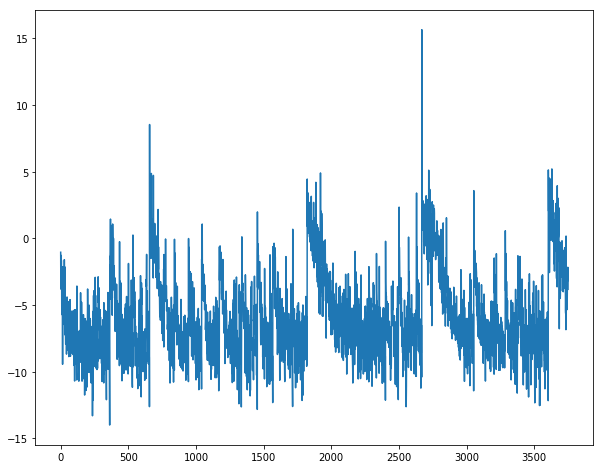

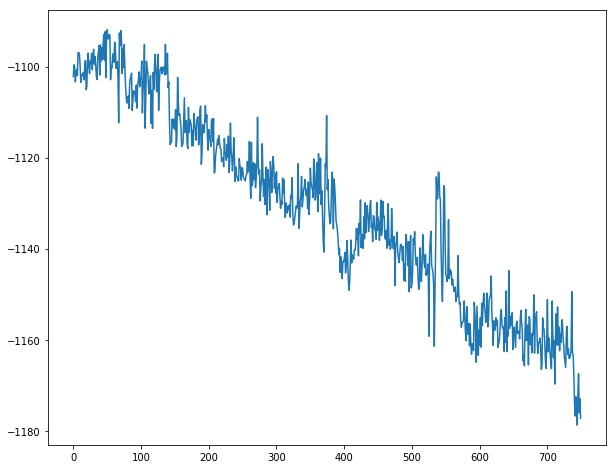

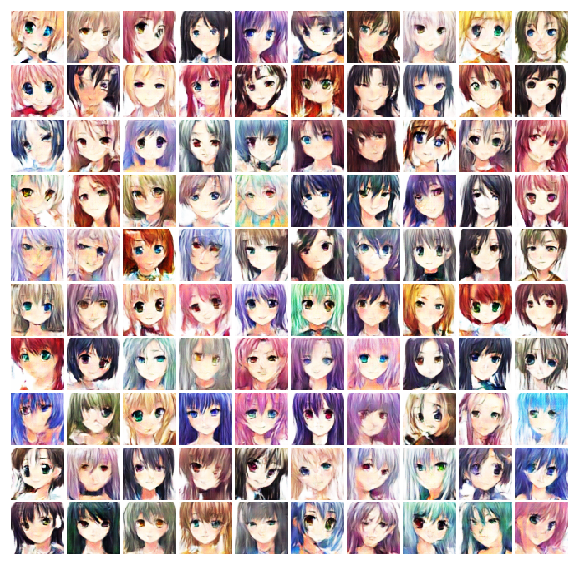


Iter: 2250/5740, D: -3.088, G:-1.181e+03
Iter: 2300/5740, D: -10.23, G:-1.168e+03
Iter: 2350/5740, D: -13.53, G:-1.166e+03
Iter: 2400/5740, D: -5.624, G:-1.193e+03
Iter: 2450/5740, D: -6.909, G:-1.189e+03


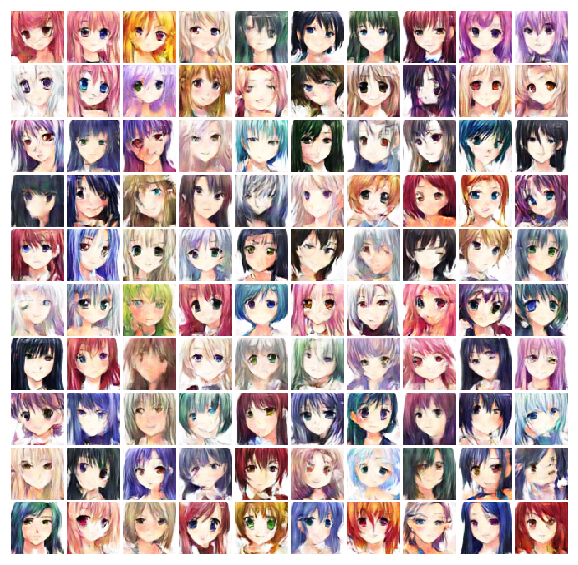


Iter: 2500/5740, D: -5.867, G:-1.2e+03
Iter: 2550/5740, D: -5.361, G:-1.206e+03
Iter: 2600/5740, D: -6.011, G:-1.209e+03
Iter: 2650/5740, D: -6.978, G:-1.22e+03
Iter: 2700/5740, D: -8.066, G:-1.221e+03


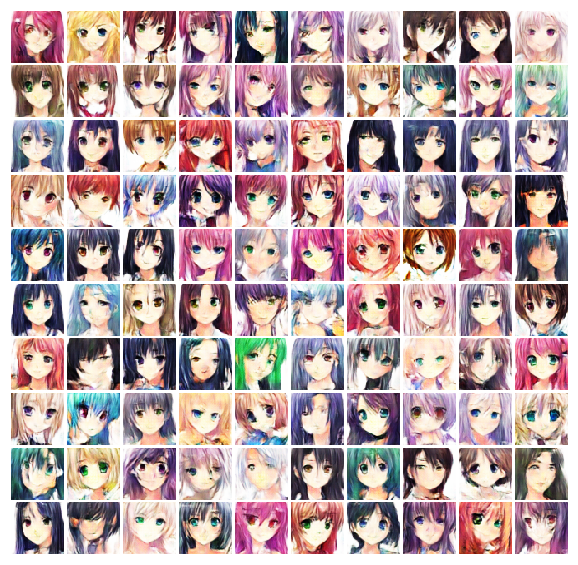


Iter: 2750/5740, D: -5.455, G:-1.231e+03
Iter: 2800/5740, D: -6.397, G:-1.23e+03
Iter: 2850/5740, D: -7.414, G:-1.23e+03
Iter: 2900/5740, D: -6.211, G:-1.231e+03
Iter: 2950/5740, D: -6.456, G:-1.238e+03


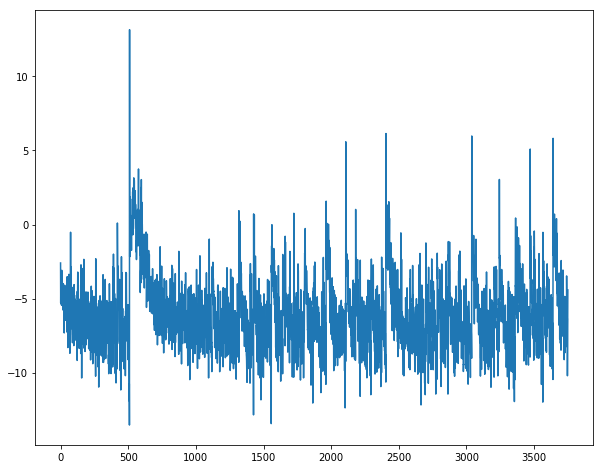

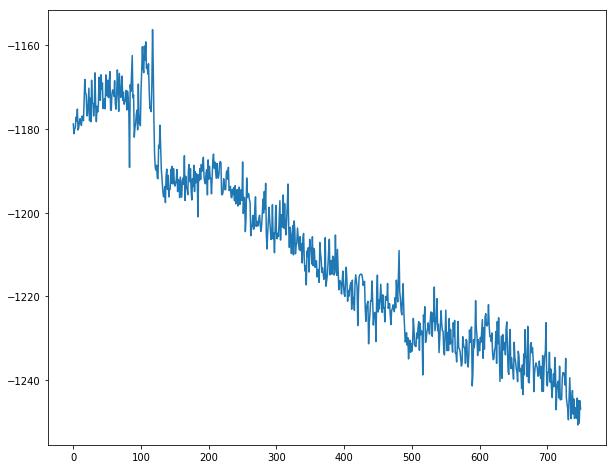

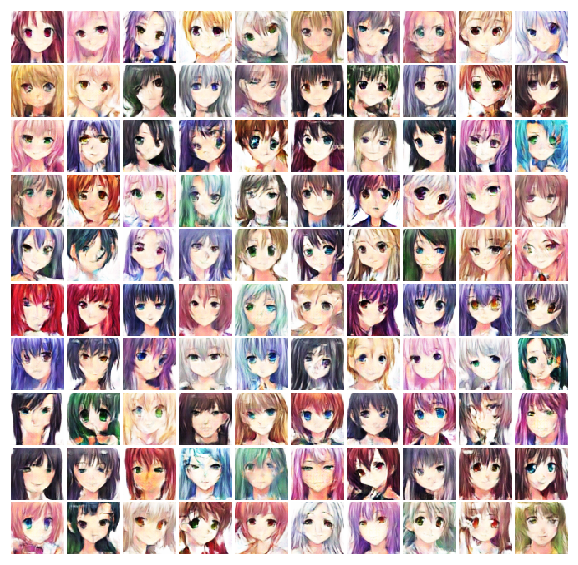


Iter: 3000/5740, D: -7.801, G:-1.247e+03
Iter: 3050/5740, D: -0.132, G:-1.231e+03
Iter: 3100/5740, D: -7.969, G:-1.259e+03
Iter: 3150/5740, D: -6.74, G:-1.256e+03
Iter: 3200/5740, D: -9.814, G:-1.266e+03


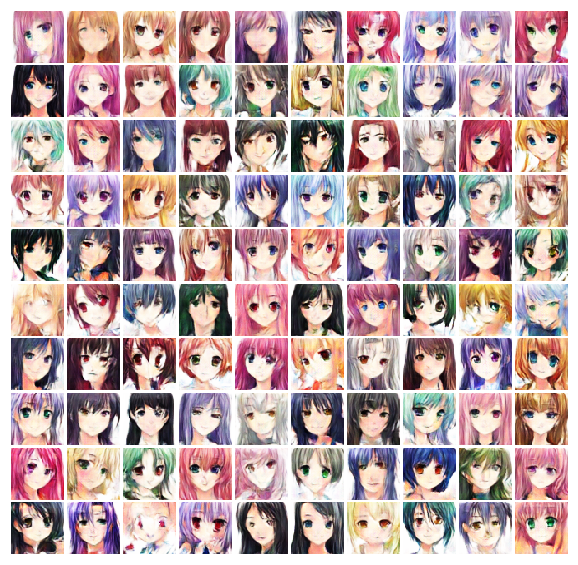


Iter: 3250/5740, D: -8.831, G:-1.272e+03
Iter: 3300/5740, D: -4.462, G:-1.285e+03
Iter: 3350/5740, D: -3.419, G:-1.274e+03
Iter: 3400/5740, D: -8.118, G:-1.282e+03
Iter: 3450/5740, D: -8.901, G:-1.286e+03


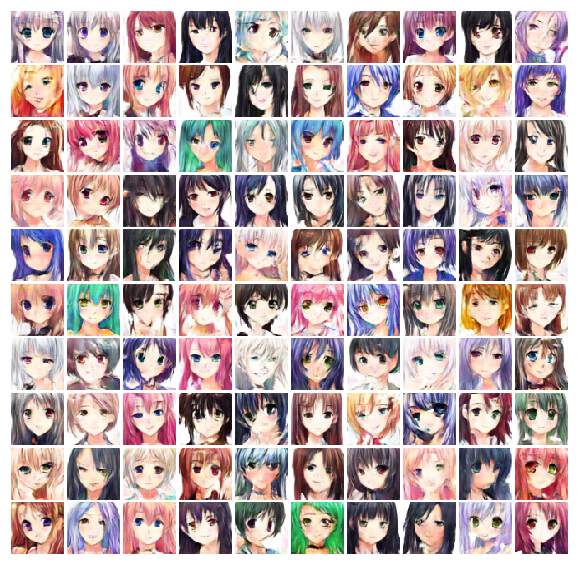


Iter: 3500/5740, D: -7.941, G:-1.288e+03
Iter: 3550/5740, D: -1.917, G:-1.273e+03
Iter: 3600/5740, D: -3.698, G:-1.203e+03
Iter: 3650/5740, D: -1.143, G:-1.25e+03
Iter: 3700/5740, D: -0.4467, G:-1.242e+03


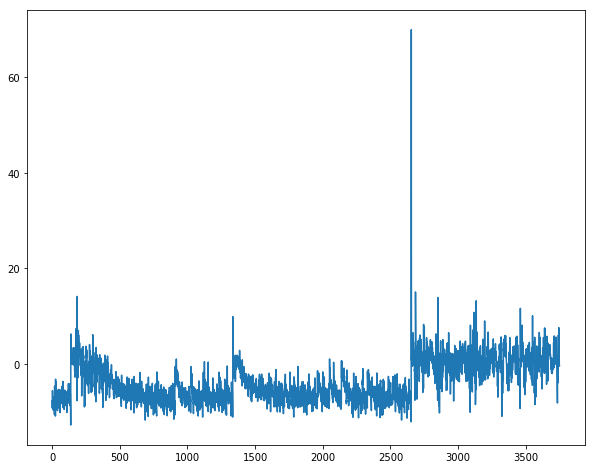

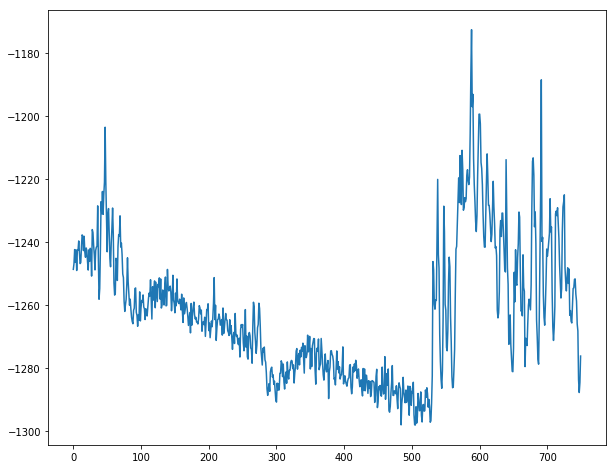

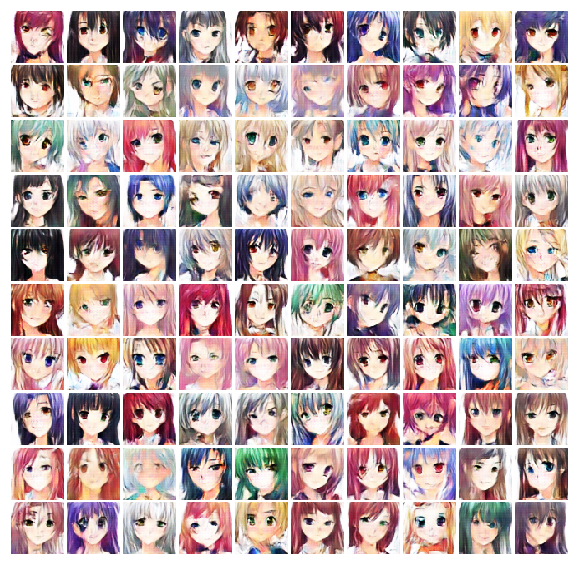


Iter: 3750/5740, D: 2.323, G:-1.23e+03
Iter: 3800/5740, D: 3.768, G:-1.235e+03
Iter: 3850/5740, D: -1.079, G:-1.268e+03
Iter: 3900/5740, D: -0.5097, G:-1.208e+03
Iter: 3950/5740, D: 1.075, G:-1.249e+03


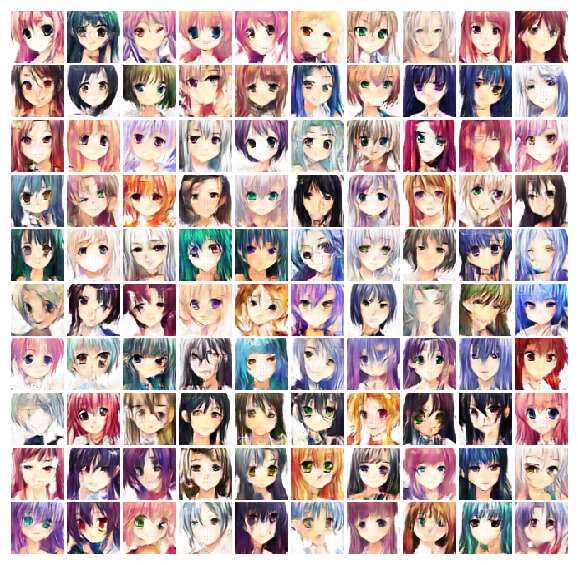


Iter: 4000/5740, D: 0.5992, G:-1.251e+03
Iter: 4050/5740, D: -1.02, G:-1.251e+03
Iter: 4100/5740, D: 0.9963, G:-1.233e+03
Iter: 4150/5740, D: 6.534, G:-1.257e+03
Iter: 4200/5740, D: -0.05251, G:-1.243e+03


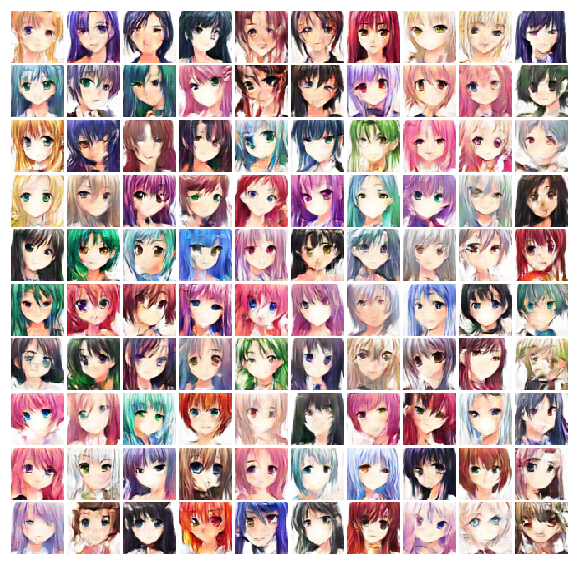


Iter: 4250/5740, D: 0.3161, G:-1.252e+03
Iter: 4300/5740, D: -0.5157, G:-1.272e+03
Iter: 4350/5740, D: -2.689, G:-1.277e+03
Iter: 4400/5740, D: -5.177, G:-1.305e+03
Iter: 4450/5740, D: -2.216, G:-1.335e+03


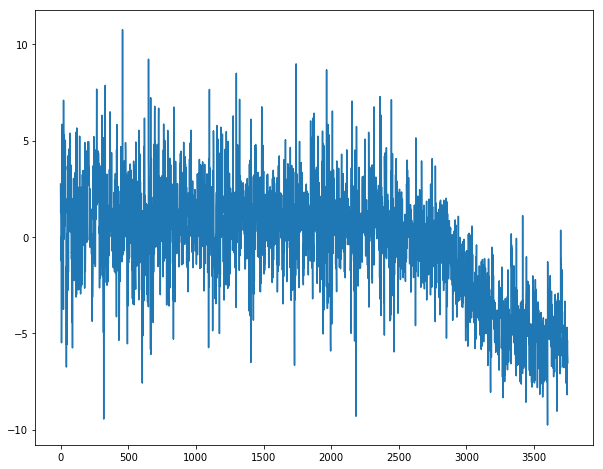

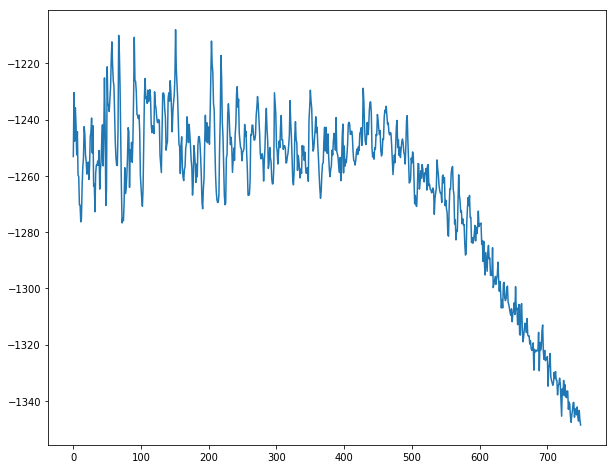

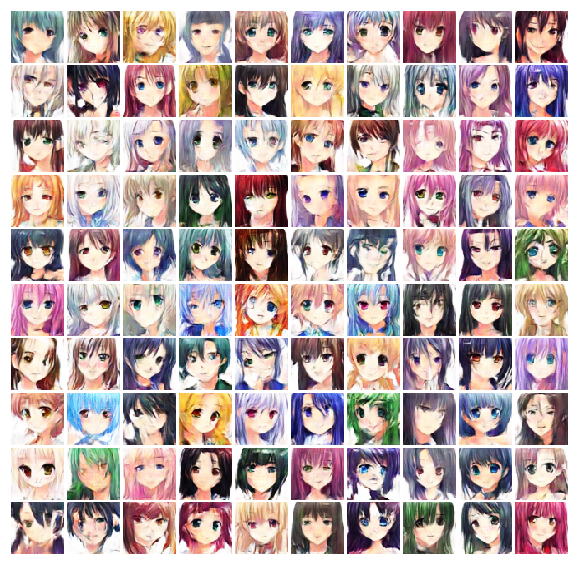


Iter: 4500/5740, D: -5.367, G:-1.352e+03
Iter: 4550/5740, D: -6.925, G:-1.361e+03
Iter: 4600/5740, D: -0.5557, G:-1.384e+03
Iter: 4650/5740, D: -6.259, G:-1.382e+03
Iter: 4700/5740, D: -7.954, G:-1.384e+03


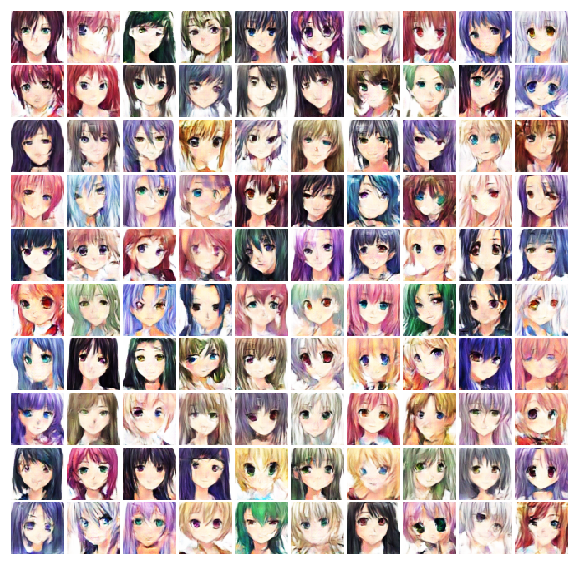


Iter: 4750/5740, D: -8.532, G:-1.397e+03
Iter: 4800/5740, D: -5.63, G:-1.404e+03
Iter: 4850/5740, D: -2.033, G:-1.418e+03
Iter: 4900/5740, D: -6.571, G:-1.426e+03
Iter: 4950/5740, D: -6.051, G:-1.434e+03


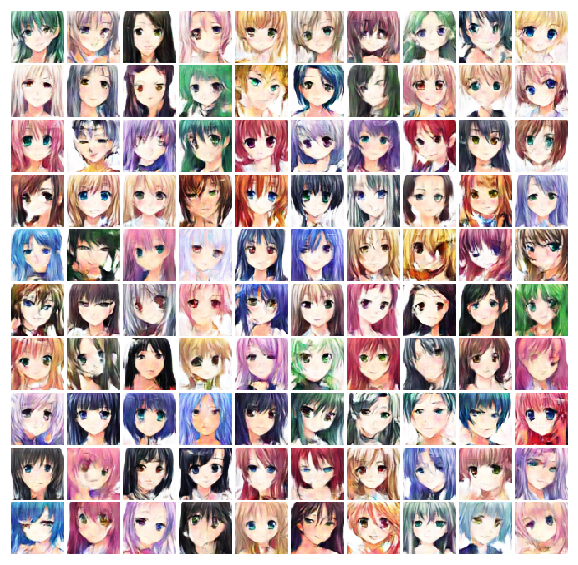


Iter: 5000/5740, D: -4.824, G:-1.441e+03
Iter: 5050/5740, D: -8.758, G:-1.441e+03
Iter: 5100/5740, D: -4.313, G:-1.457e+03
Iter: 5150/5740, D: -2.636, G:-1.337e+03
Iter: 5200/5740, D: 0.7704, G:-1.311e+03


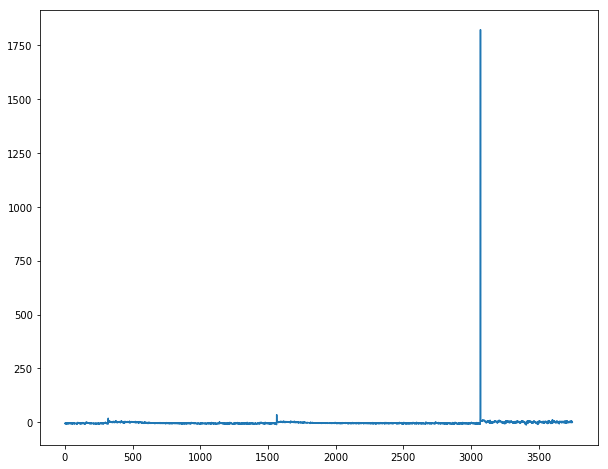

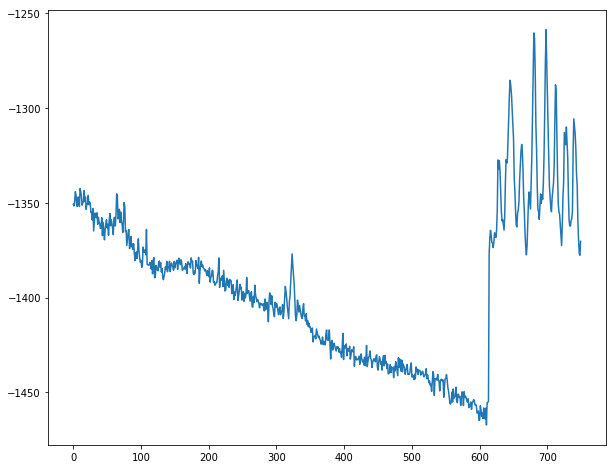

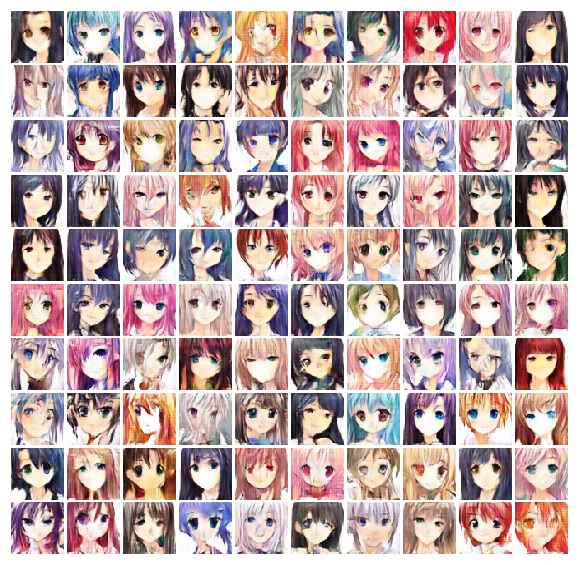


Iter: 5250/5740, D: -5.142, G:-1.361e+03
Iter: 5300/5740, D: -3.885, G:-1.365e+03
Iter: 5350/5740, D: -4.857, G:-1.337e+03
Iter: 5400/5740, D: 0.2654, G:-1.315e+03
Iter: 5450/5740, D: -0.07078, G:-1.273e+03


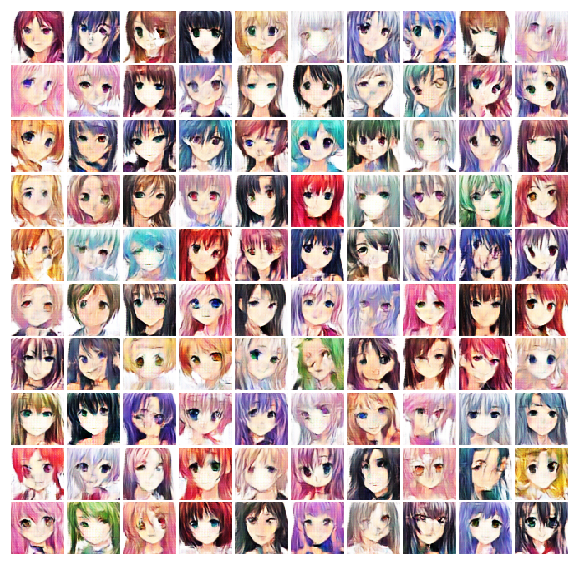


Iter: 5500/5740, D: 1.608, G:-1.293e+03
Iter: 5550/5740, D: 6.067, G:-1.325e+03
Iter: 5600/5740, D: 5.572, G:-1.223e+03
Iter: 5650/5740, D: 0.9986, G:-1.349e+03
Iter: 5700/5740, D: 5.69, G:-1.358e+03
Final images


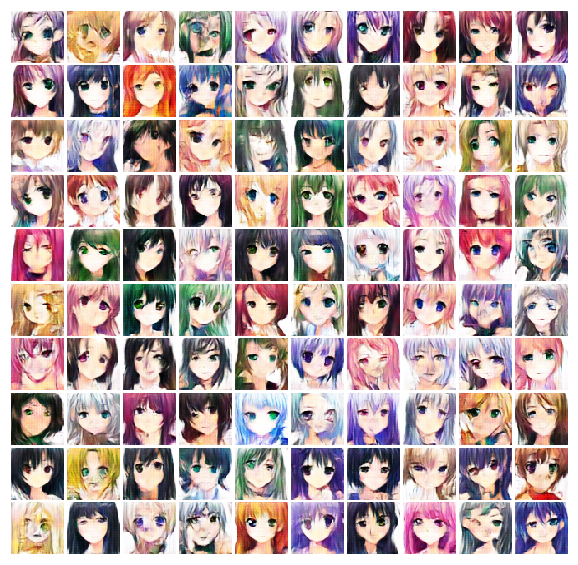

In [9]:
saver = tf.train.Saver()
config = tf.ConfigProto()
config.gpu_options.allow_growth = True
with tf.Session(config=config) as sess:
    sess.run(tf.global_variables_initializer())
    
    ckpt =  tf.train.get_checkpoint_state(os.path.dirname('checkpoints/checkpoint'))
    if ckpt and ckpt.model_checkpoint_path:
        saver.restore(sess, ckpt.model_checkpoint_path)
        
    run_a_gan(sess, G_train_step, G_loss, D_train_step, D_loss, G_extra_step, D_extra_step, saver, batch_size=batch_size, num_epoch=50)